## Testing image extraction

30


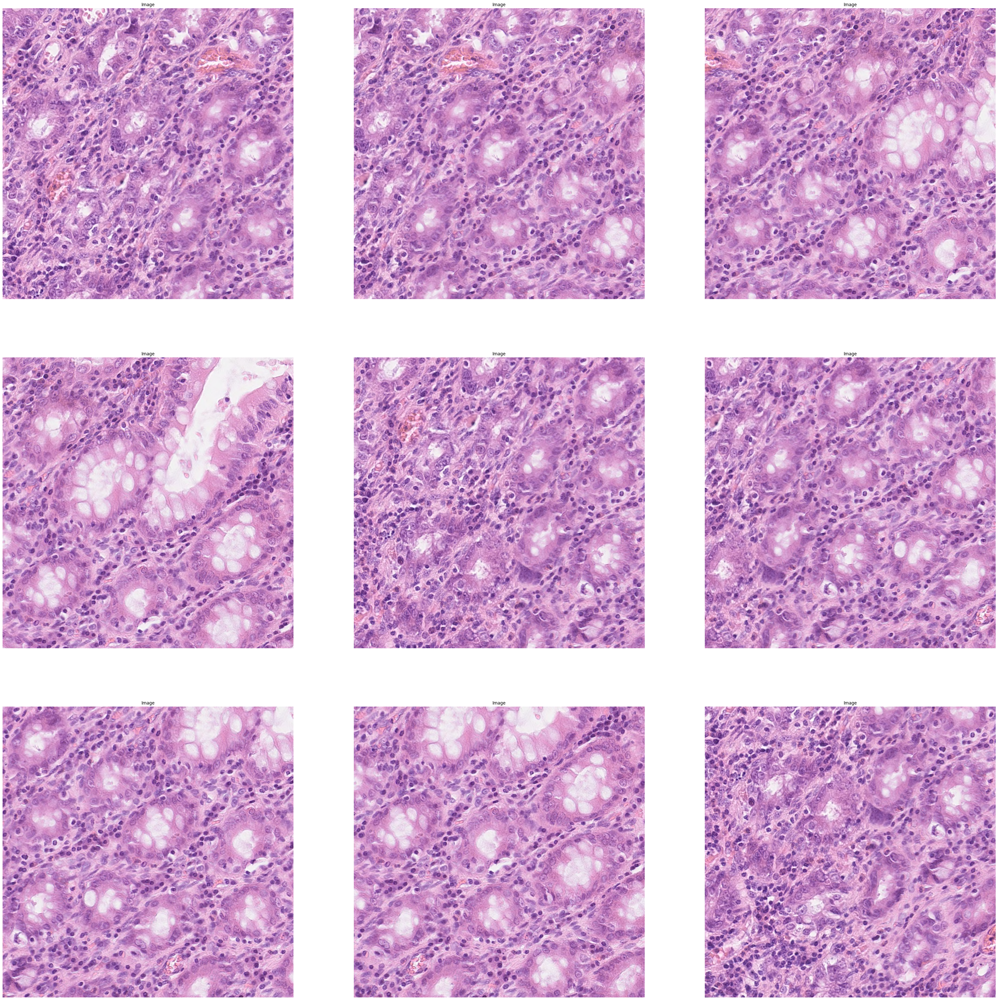

In [1]:
# test image extraction
import glob
from PIL import Image
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt

def extract_patches(array, array_name, patch_size, patch_step):
    """Extract patches from an image.

    Args:
        array (np.array): array to be patched.
        array_name (str): name of the array.
        patch_size (int): size of the patches.
        patch_step (int): step between patches.

    Returns:
        array_dict (dict): dictionary of array patches.

    Raises:
        None.

    """
    array_dict = {}
    count = 0
    # extract patches
    for i in range(0, array.shape[0], patch_step):
        for j in range(0, array.shape[1], patch_step):
            patch = array[i : i + patch_size, j : j + patch_size]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{i}_{j}"] = patch
                count+=1
    # add missing patches
    if array.shape[0] % patch_step != 0:
        for j in range(0, array.shape[1], patch_step):
            patch = array[-patch_size:, j : j + patch_size]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{array.shape[0] - patch_size}_{j}"] = patch
                count+=1
    if array.shape[1] % patch_step != 0:
        for i in range(0, array.shape[0], patch_step):
            patch = array[i : i + patch_size, -patch_size:]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{i}_{array.shape[1] - patch_size}"] = patch
                count+=1
    if array.shape[0] % patch_step != 0 and array.shape[1] % patch_step != 0:
        patch = array[-patch_size:, -patch_size:]
        if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
            array_dict[
                array_name
                + f"_{array.shape[0] - patch_size}_{array.shape[1] - patch_size}"
            ] = patch
            count+=1
            
    print(count)
    return array_dict

def extract_image_patches(image_file, patch_size, patch_step):
    """Extract patches from an image.

    Args:
        image_file (str): path to the image file.
        patch_size (int): size of the patches.
        patch_step (int): step between patches.

    Returns:
        images (dict): dictionary of images with the new patches.

    Raises:
        None.

    """
    # load image
    image = Image.open(image_file)
    image = np.array(image)
    # extract patches
    name = Path(image_file).stem.split(".")[0]
    images_dict = extract_patches(image, name, patch_size, patch_step)
    return images_dict

IMAGE_PATH = "data/Lizard_dataset/Lizard_Images1/*.png"
IMG_SIZE=540

image_files = glob.glob(IMAGE_PATH)

# extract patches from the images to have multiple images of same size:
imgs = extract_image_patches(image_files[0], 540, 200)
    
fig, axs = plt.subplots(3, 3, figsize=(50, 50))
for i, a in enumerate(imgs):
    if i >= 9:
        break
    y=int(i/3)
    x=i%3
    axs[y][x].axis('off')
    axs[y][x].set_title("Image")
    axs[y][x].imshow(imgs[a].reshape(IMG_SIZE,IMG_SIZE,3))

In [37]:
import glob
import pandas as pd
import scipy.io as sio
from tqdm import tqdm


def extract_annotation_patches(annotation_file, annotations, patch_size, patch_step):
    """Extract patches from annotations.

    Args:
        annotation_file (str): path to the annotation file.
        annotations (pd.Dataframe): dataframe of annotations.
        patch_size (int): size of the patches.
        patch_step (int): step between patches.

    Returns:
        annotations (pd.Dataframe): dataframe of annotations with the new patches.

    Raises:
        None.

    """
    # load the annotation file
    mat_file = sio.loadmat(annotation_file)

    # extract patches for inst_map
    name = Path(annotation_file).stem.split(".")[0]
    inst_map = np.array(mat_file["inst_map"])

    inst_map_dict = extract_patches(inst_map, name, patch_size, patch_step)

    # update annotation data for each patches
    for key, value in tqdm(
        inst_map_dict.items(),
        desc="Extracting annotation patches",
        position=1,
        leave=False,
    ):
        patch_id = np.unique(value).tolist()[1:]
        # patch_id_no_bg = patch_id[patch_id != 0] - 1
        # print("num_id with no bg", len(patch_id_no_bg))
        # keep only values present in the patch
        nuclei_id = np.squeeze(mat_file["id"]).tolist()# [patch_id_no_bg]
        classes = []
        bbox = []
        centroids = []
        class_map = np.zeros(value.shape)
        for v in patch_id:
            idx = nuclei_id.index(v)
            classes.append(mat_file["class"][idx])
            bbox.append(mat_file["bbox"][idx])
            centroids.append(mat_file["centroid"][idx])
            class_map[value == v] = mat_file["class"][idx]
        # add the new patch to the dataframe
        annotations = pd.concat(
            [
                annotations,
                pd.DataFrame(
                    {
                        "id": [key],
                        "inst_map": [value],
                        "class_map": [class_map],
                        "nuclei_id": [nuclei_id],
                        "classes": [classes],
                        "bbox": [bbox],
                        "centroids": [centroids],
                    }
                ),
            ],
            ignore_index=True,
        )
    return annotations

def extract_patches(array, array_name, patch_size, patch_step):
    """Extract patches from an image.

    Args:
        array (np.array): array to be patched.
        array_name (str): name of the array.
        patch_size (int): size of the patches.
        patch_step (int): step between patches.

    Returns:
        array_dict (dict): dictionary of array patches.

    Raises:
        None.

    """
    array_dict = {}
    # extract patches
    for i in range(0, array.shape[0], patch_step):
        for j in range(0, array.shape[1], patch_step):
            patch = array[i : i + patch_size, j : j + patch_size]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{i}_{j}"] = patch
    # add missing patches
    if array.shape[0] % patch_step != 0:
        for j in range(0, array.shape[1], patch_step):
            patch = array[-patch_size:, j : j + patch_size]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{array.shape[0] - patch_size}_{j}"] = patch
    if array.shape[1] % patch_step != 0:
        for i in range(0, array.shape[0], patch_step):
            patch = array[i : i + patch_size, -patch_size:]
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                array_dict[array_name + f"_{i}_{array.shape[1] - patch_size}"] = patch
    if array.shape[0] % patch_step != 0 and array.shape[1] % patch_step != 0:
        patch = array[-patch_size:, -patch_size:]
        if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
            array_dict[
                array_name
                + f"_{array.shape[0] - patch_size}_{array.shape[1] - patch_size}"
            ] = patch

    return array_dict

In [38]:
ANN_PATH = "data/Lizard_dataset/Lizard_Labels/Labels/*.mat"
IMG_SIZE=540

annot_files = glob.glob(ANN_PATH)

annotations = pd.DataFrame(
        columns=[
            "id",
            "inst_map",
            "class_map",
            "nuclei_id",
            "classes",
            "bboxs",
            "centroids",
        ]
    )

# extract patches from the images to have multiple images of same size:
ann = extract_annotation_patches(annot_files[0], annotations, 540, 200)


Extracting annotation patches:   0%|                                                                                                                            | 0/36 [00:00<?, ?it/s]

num_id = 498



Extracting annotation patches:   6%|██████▍                                                                                                             | 2/36 [00:00<00:06,  4.91it/s]

num_id = 540
num_id = 584



Extracting annotation patches:  11%|████████████▉                                                                                                       | 4/36 [00:00<00:06,  4.90it/s]

num_id = 558



Extracting annotation patches:  14%|████████████████                                                                                                    | 5/36 [00:01<00:06,  4.95it/s]

num_id = 563
num_id = 494



Extracting annotation patches:  19%|██████████████████████▌                                                                                             | 7/36 [00:01<00:05,  5.05it/s]

num_id = 553



Extracting annotation patches:  22%|█████████████████████████▊                                                                                          | 8/36 [00:01<00:05,  5.07it/s]

num_id = 557
num_id = 537



Extracting annotation patches:  25%|█████████████████████████████                                                                                       | 9/36 [00:01<00:05,  5.02it/s]

num_id = 565



Extracting annotation patches:  28%|███████████████████████████████▉                                                                                   | 10/36 [00:02<00:05,  4.61it/s]

num_id = 501



Extracting annotation patches:  31%|███████████████████████████████████▏                                                                               | 11/36 [00:02<00:05,  4.58it/s]

num_id = 565



Extracting annotation patches:  33%|██████████████████████████████████████▎                                                                            | 12/36 [00:02<00:05,  4.40it/s]

num_id = 553



Extracting annotation patches:  39%|████████████████████████████████████████████▋                                                                      | 14/36 [00:02<00:04,  4.53it/s]

num_id = 534
num_id = 557



Extracting annotation patches:  44%|███████████████████████████████████████████████████                                                                | 16/36 [00:03<00:04,  4.65it/s]

num_id = 491
num_id = 540



Extracting annotation patches:  50%|█████████████████████████████████████████████████████████▌                                                         | 18/36 [00:03<00:03,  4.74it/s]

num_id = 523



Extracting annotation patches:  53%|████████████████████████████████████████████████████████████▋                                                      | 19/36 [00:04<00:03,  4.81it/s]

num_id = 510



Extracting annotation patches:  56%|███████████████████████████████████████████████████████████████▉                                                   | 20/36 [00:04<00:03,  4.89it/s]

num_id = 544
num_id = 525



Extracting annotation patches:  58%|███████████████████████████████████████████████████████████████████                                                | 21/36 [00:04<00:03,  4.93it/s]


num_id = 571


Extracting annotation patches:  61%|██████████████████████████████████████████████████████████████████████▎                                            | 22/36 [00:04<00:02,  4.89it/s]

num_id = 564



Extracting annotation patches:  64%|█████████████████████████████████████████████████████████████████████████▍                                         | 23/36 [00:04<00:02,  4.78it/s]

num_id = 576



Extracting annotation patches:  67%|████████████████████████████████████████████████████████████████████████████▋                                      | 24/36 [00:05<00:02,  4.62it/s]

num_id = 594



Extracting annotation patches:  69%|███████████████████████████████████████████████████████████████████████████████▊                                   | 25/36 [00:05<00:02,  4.37it/s]

num_id = 542



Extracting annotation patches:  72%|███████████████████████████████████████████████████████████████████████████████████                                | 26/36 [00:05<00:02,  4.27it/s]

num_id = 552



Extracting annotation patches:  75%|██████████████████████████████████████████████████████████████████████████████████████▎                            | 27/36 [00:05<00:02,  4.37it/s]

num_id = 566



Extracting annotation patches:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                         | 28/36 [00:06<00:01,  4.24it/s]

num_id = 596



Extracting annotation patches:  81%|████████████████████████████████████████████████████████████████████████████████████████████▋                      | 29/36 [00:06<00:01,  4.25it/s]

num_id = 645



Extracting annotation patches:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▊                   | 30/36 [00:06<00:01,  4.02it/s]

num_id = 593



Extracting annotation patches:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████                | 31/36 [00:06<00:01,  3.94it/s]

num_id = 607



Extracting annotation patches:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 32/36 [00:07<00:01,  3.98it/s]

num_id = 604



Extracting annotation patches:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 33/36 [00:07<00:00,  4.10it/s]

num_id = 594



Extracting annotation patches:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 34/36 [00:07<00:00,  4.27it/s]

num_id = 604



Extracting annotation patches:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 35/36 [00:07<00:00,  4.17it/s]

num_id = 618



Extracting annotation patches: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:08<00:00,  4.03it/s]
                                                                                                                                                                                       

Index(['id', 'inst_map', 'class_map', 'nuclei_id', 'classes', 'bboxs',
       'centroids', 'bbox'],
      dtype='object')


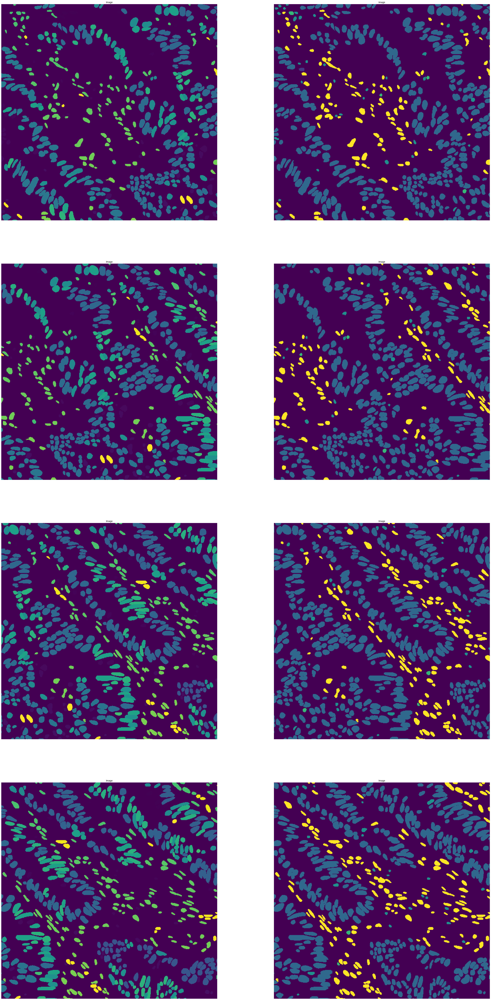

In [40]:
print(ann.keys())

fig, axs = plt.subplots(4, 2, figsize=(50, 100))
for i in range(4):
    axs[i][0].axis('off')
    axs[i][0].set_title("Image")
    axs[i][0].imshow(ann["inst_map"][i])
    axs[i][1].axis('off')
    axs[i][1].set_title("Image")
    axs[i][1].imshow(ann["class_map"][i])

## Testing pickle loading

In [2]:
import pickle
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2

IMG_SIZE=540
DATA_PATH="data_540_200_v2.pkl"
data_path = Path(DATA_PATH)
with data_path.open("rb") as f:
    data = pickle.load(f)





In [3]:
annotations=data["annotations"]
print(annotations.keys())
images = data["images"]

Index(['id', 'inst_map', 'class_map'], dtype='object')


In [4]:

tf_augment = A.Compose(
    [
        A.Resize(IMG_SIZE, IMG_SIZE),
        A.Normalize(mean=0, std=1),
        # A.HorizontalFlip(),
        A.RandomBrightnessContrast(p=0.2),
        ToTensorV2(),
    ]
)

    
num_example = 4

fig, axs = plt.subplots(num_example, 3, figsize=(150, 50*num_example))

i = 0
for im in images.values():
    if i == num_example:
        break
    image = np.array(im)
    image = tf_augment(image=image)["image"]
    im = annotations['inst_map'][i]
    cm = annotations['class_map'][i]
    
    axs[i][0].axis('off')
    axs[i][0].set_title("Original")
    axs[i][0].imshow(image.permute(1, 2, 0))
    axs[i][1].axis('off')
    axs[i][1].set_title("instancemap")
    axs[i][1].imshow(im)
    axs[i][2].axis('off')
    axs[i][2].set_title("classmap")
    axs[i][2].imshow(cm)
    i+= 1

## Test stardist data

In [1]:
import matplotlib.pyplot as plt
import math

from stardist.matching import matching_dataset

from sflizard import LizardDataModule

warnings.py (30): You want to use `wandb` which is not installed yet, install it with `pip install wandb`.
warnings.py (30): You want to use `gym` which is not installed yet, install it with `pip install gym`.


In [2]:
IMG_SIZE=540
DATA_PATH="data-540-200.pkl"
SEED=303
BATCH_SIZE=4
N_RAYS = 32

ANNOTATION_TARGET = "inst"


In [3]:
aditional_args={"n_rays":N_RAYS}

# create the datamodule
dm = LizardDataModule(
    data_path=DATA_PATH,
    annotation_target=ANNOTATION_TARGET,
    batch_size=BATCH_SIZE,
    input_size=IMG_SIZE,
    seed=SEED,
    aditional_args=aditional_args,
)
dm.setup()


Training with 2422 examples


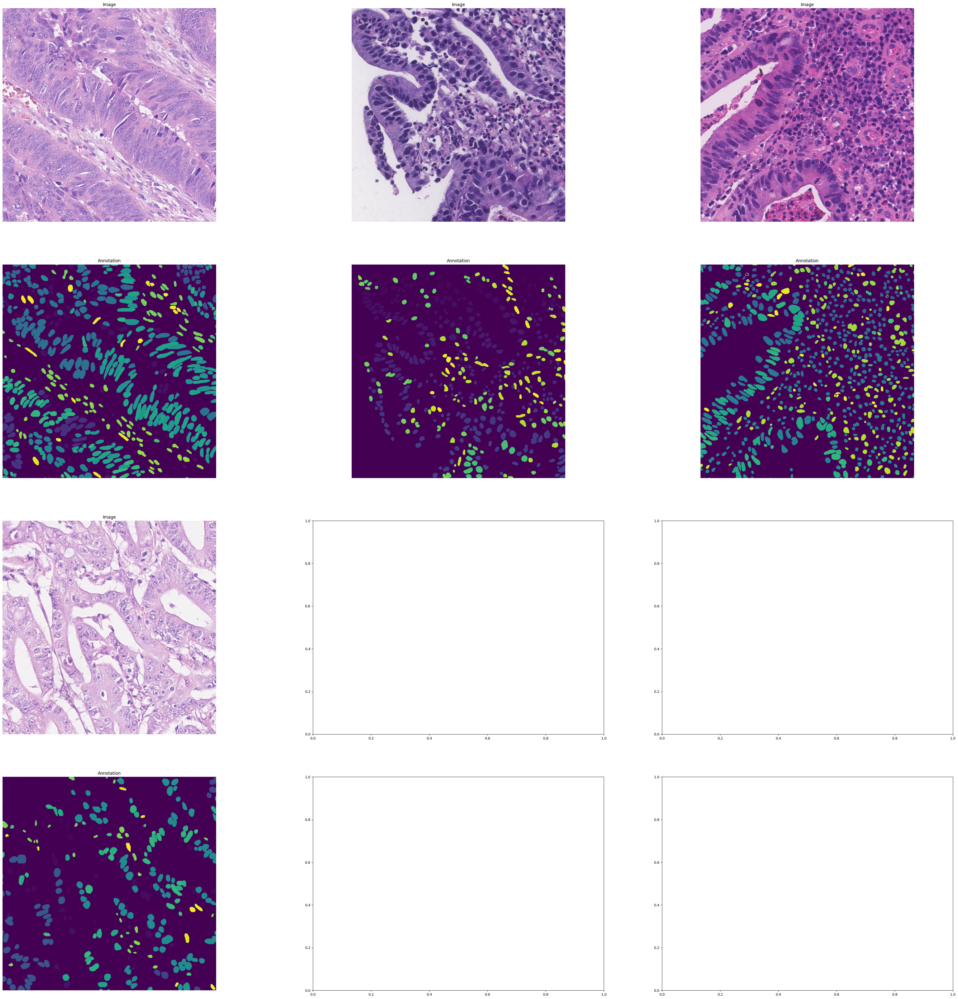

In [4]:
# get test data
inputs, annotation = next(iter(dm.test_dataloader()))

fig, axs = plt.subplots(2*math.ceil(BATCH_SIZE/3), 3, figsize=(50, 50))

for i in range(len(inputs)):
    y=int(i/3)*2
    x=i%3
    axs[y][x].axis('off')
    axs[y][x].set_title("Image")
    axs[y][x].imshow(inputs[i].permute(1, 2, 0))
    axs[y+1][x].axis('off')
    axs[y+1][x].set_title("Annotation")
    axs[y+1][x].imshow(annotation[i])

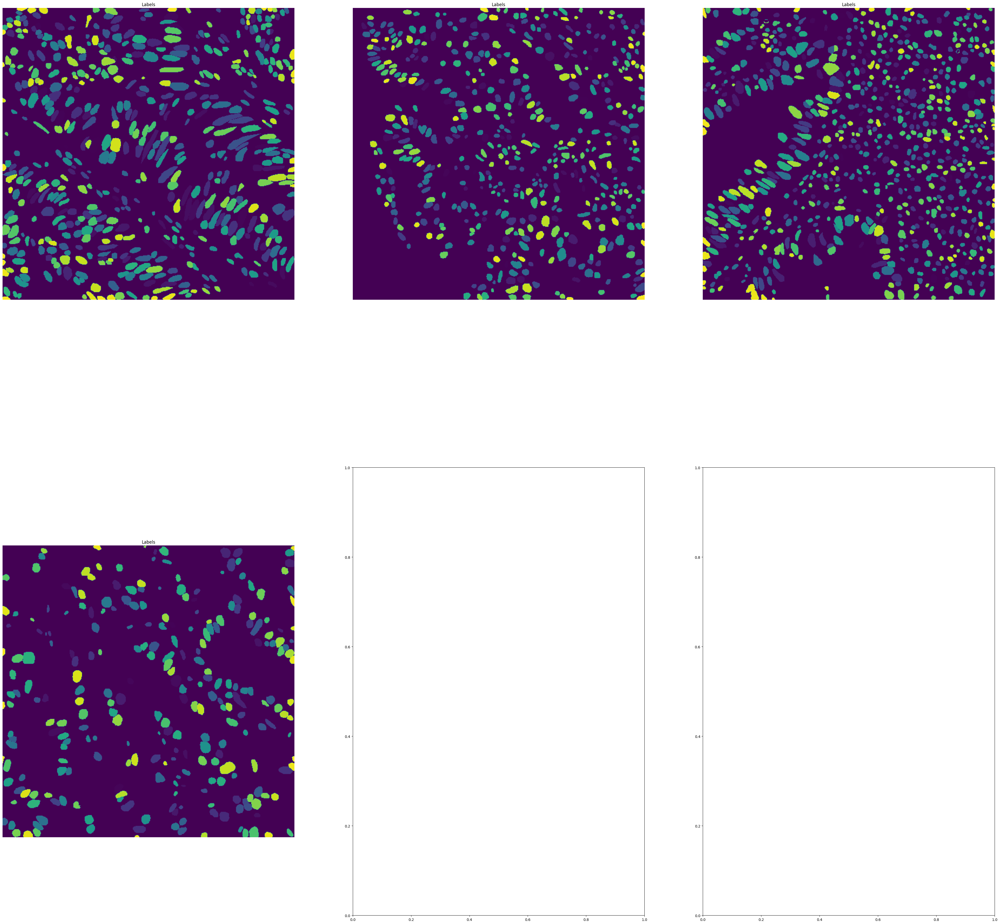

In [5]:
import torch
from stardist import star_dist, edt_prob
from stardist import non_maximum_suppression, polygons_to_label
import numpy as np

N_RAYS=32

dists = []
probs = []

for i in range(annotation.shape[0]):
    dist = star_dist(annotation[i].numpy(), N_RAYS)
    dist = torch.from_numpy(np.transpose(dist, (2, 0, 1)))
    prob = edt_prob(annotation[i].numpy())
    prob = torch.from_numpy(np.expand_dims(prob, 0))
    dists.append(dist.unsqueeze(0))
    probs.append(prob.unsqueeze(0))
    

dist = torch.cat(dists)
prob = torch.cat(probs)

star_labels = []
for i in range(inputs.shape[0]):
    dist_numpy = dist[i].detach().cpu().numpy().squeeze()
    prob_numpy = prob[i].detach().cpu().numpy().squeeze()
    dist_numpy = np.transpose(dist_numpy, (1, 2, 0))
    points, probs, dists = non_maximum_suppression(
        dist_numpy, prob_numpy, nms_thresh=0.5, prob_thresh=0.5
    )
    star_label = polygons_to_label(
        dists, points, (IMG_SIZE, IMG_SIZE), probs
    )
    star_labels.append(star_label)
    
fig, axs = plt.subplots(2, 3, figsize=(50, 50))

for i in range(len(star_labels)):
    star_labels[i] = star_labels[i] / np.max(star_labels[i])
    y=int(i/3)
    x=i%3
    axs[y][x].axis('off')
    axs[y][x].set_title("Labels")
    axs[y][x].imshow(star_labels[i]) #np.transpose(star_labels[i], (1,2,0)))

## Test stardist base inference

In [ ]:
import matplotlib.pyplot as plt
import math

from stardist.matching import matching_dataset

from sflizard import Stardist
from sflizard import LizardDataModule

In [ ]:
IMG_SIZE=540
DATA_PATH="data-540-200.pkl"
SEED=303
BATCH_SIZE=4
N_RAYS=32
IN_CHANNELS=3

ANNOTATION_TARGET = "stardist"

In [ ]:
aditional_args={"n_rays":N_RAYS}

# create the datamodule
dm = LizardDataModule(
    data_path=DATA_PATH,
    annotation_target=ANNOTATION_TARGET,
    batch_size=BATCH_SIZE,
    input_size=IMG_SIZE,
    seed=SEED,
    aditional_args=aditional_args,
)
dm.setup()

# create the model
model = Stardist(
    input_size=IMG_SIZE,
    in_channels=IN_CHANNELS,
    n_rays=N_RAYS,
    seed=SEED,
)

In [ ]:
inputs, targets, distances = next(iter(dm.test_dataloader()))

# send to model
dist, prob = model.forward(inputs)

In [ ]:
mask_true = model.model.compute_star_label(inputs, distances, targets)
print(mask_true.shape)
mask_pred = model.model.compute_star_label(inputs, dist, prob)
print(mask_pred.shape)


In [ ]:
metrics = matching_dataset(mask_true, mask_pred)
print(metrics)

In [ ]:
fig, axs = plt.subplots(3*math.ceil(BATCH_SIZE/3), 3, figsize=(30, 30))

for i in range(len(inputs)):
    y=int(i/3)*3
    x=i%3
    axs[y][x].axis('off')
    axs[y][x].set_title("Image")
    axs[y][x].imshow(inputs[i].permute(1, 2, 0))
    axs[y+1][x].axis('off')
    axs[y+1][x].set_title("Mask True")
    axs[y+1][x].imshow(mask_true[i])
    axs[y+2][x].axis('off')
    axs[y+2][x].set_title("Mask Pred")
    axs[y+2][x].imshow(mask_pred[i])

## test stardist from checkpoint

In [ ]:
import matplotlib.pyplot as plt
import math

from stardist.matching import matching_dataset

from sflizard import Stardist
from sflizard import LizardDataModule



In [ ]:
IMG_SIZE=540
DATA_PATH="data-540-200.pkl"
SEED=303
BATCH_SIZE=4
N_RAYS=32
IN_CHANNELS=3

ANNOTATION_TARGET = "stardist"

CHECKPOINT= "models/full_training_stardist.ckpt"

In [ ]:
aditional_args={"n_rays":N_RAYS}

# create the datamodule
dm = LizardDataModule(
    data_path=DATA_PATH,
    annotation_target=ANNOTATION_TARGET,
    batch_size=BATCH_SIZE,
    input_size=IMG_SIZE,
    seed=SEED,
    aditional_args=aditional_args,
)
dm.setup()


In [ ]:
# create the model
model = Stardist.load_from_checkpoint(
        CHECKPOINT 
    )

In [ ]:
inputs, targets, distances = next(iter(dm.test_dataloader()))

# send to model
dist, prob = model.forward(inputs)

In [ ]:
mask_true = model.model.compute_star_label(inputs, distances, targets)
print(mask_true.shape)
mask_pred = model.model.compute_star_label(inputs, dist, prob)
print(mask_pred.shape)


In [ ]:
metrics = matching_dataset(mask_true, mask_pred)
print(metrics)

In [ ]:
fig, axs = plt.subplots(3*math.ceil(BATCH_SIZE/3), 3, figsize=(30, 60))

for i in range(len(inputs)):
    y=int(i/3)*3
    x=i%3
    axs[y][x].axis('off')
    axs[y][x].set_title("Image")
    axs[y][x].imshow(inputs[i].permute(1, 2, 0))
    axs[y+1][x].axis('off')
    axs[y+1][x].set_title("Mask True")
    axs[y+1][x].imshow(mask_true[i])
    axs[y+2][x].axis('off')
    axs[y+2][x].set_title("Mask Pred")
    axs[y+2][x].imshow(mask_pred[i])